In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
# from sklearn.feature_extraction.text import CountVectorizer
# import nltk 
import string
import re
import os
import glob
import ast
import collections
# !pip install wordcloud
from wordcloud import WordCloud
# !pip install hazm
from hazm import *


%matplotlib inline

pd.set_option('display.max_colwidth', 100)
pd.set_option('display.max_rows' , 100)

# Reading csv files and concat them to one single pandas data frame

In [2]:
path = r'/Users/behdad/Learning/TwitterBot/GetOldTweets3_Twitter_Scraper/' # use your path

all_files = glob.glob(path + "/*.csv")

li = []

for filename in all_files:
    df = pd.read_csv(filename , encoding='utf-8')
    li.append(df)

dataframe = pd.concat(li, axis=0, ignore_index=True)
dataframe.to_csv('political_tweets.csv', header=True,encoding='utf-8')

## Preprocessing Data

In [3]:
df= pd.read_csv('political_tweets.csv', encoding='UTF-8')
df.shape

(65024, 8)

In [4]:
df

,Unnamed: 0,Unnamed: 0.1,Username,Datetime,Text,retweets,favorites,hashtags
0,0,0,1alpr,2020-02-06 09:29:10+00:00,میلی‌لیتر,0,2,NaN
1,1,1,1alpr,2020-02-05 09:27:28+00:00,ما گول نمی‌خوریم. یه عمریه هر طرف نگا کردیم آخوند دیدیم.,0,2,NaN
2,2,2,1alpr,2020-02-05 09:08:08+00:00,یه آخوند بی‌عمامه دیدم. داشتم نگران می‌شدم.,0,1,NaN
3,3,3,1alpr,2020-02-05 09:06:08+00:00,آخوند چرا نداره! یعنی میرن؟,0,5,NaN
4,4,4,1alpr,2020-02-03 18:20:39+00:00,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده!,0,15,NaN
...,...,...,...,...,...,...,...,...
65019,65019,675,Zarghami_ez,2016-08-28 12:42:09+00:00,متاسفانه مدیریت ‌گلخانه‌ای سینمای دهه 60 با محور قراردادن سینمای شبه‌روشنفکری و جشنواره‌پسند، مو...,1,9,NaN
65020,65020,676,Zarghami_ez,2016-08-28 12:31:05+00:00,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...,1,18,NaN
65021,65021,677,Zarghami_ez,2016-08-24 11:52:42+00:00,تصور کلی من این است که هنوز پرداخت های نجومی قطع نشده و خوب است آخرین بررسی بر روی دریافتی های د...,5,24,NaN
65022,65022,678,Zarghami_ez,2016-08-22 11:26:13+00:00,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...,0,9,NaN


In [5]:
del df['Unnamed: 0.1']
del df['Unnamed: 0']

In [6]:
df.head()

,Username,Datetime,Text,retweets,favorites,hashtags
0,1alpr,2020-02-06 09:29:10+00:00,میلی‌لیتر,0,2,NaN
1,1alpr,2020-02-05 09:27:28+00:00,ما گول نمی‌خوریم. یه عمریه هر طرف نگا کردیم آخوند دیدیم.,0,2,NaN
2,1alpr,2020-02-05 09:08:08+00:00,یه آخوند بی‌عمامه دیدم. داشتم نگران می‌شدم.,0,1,NaN
3,1alpr,2020-02-05 09:06:08+00:00,آخوند چرا نداره! یعنی میرن؟,0,5,NaN
4,1alpr,2020-02-03 18:20:39+00:00,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده!,0,15,NaN


In [7]:
df.tail()

,Username,Datetime,Text,retweets,favorites,hashtags
65019,Zarghami_ez,2016-08-28 12:42:09+00:00,متاسفانه مدیریت ‌گلخانه‌ای سینمای دهه 60 با محور قراردادن سینمای شبه‌روشنفکری و جشنواره‌پسند، مو...,1,9,NaN
65020,Zarghami_ez,2016-08-28 12:31:05+00:00,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...,1,18,NaN
65021,Zarghami_ez,2016-08-24 11:52:42+00:00,تصور کلی من این است که هنوز پرداخت های نجومی قطع نشده و خوب است آخرین بررسی بر روی دریافتی های د...,5,24,NaN
65022,Zarghami_ez,2016-08-22 11:26:13+00:00,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...,0,9,NaN
65023,Zarghami_ez,2016-08-16 12:06:11+00:00,هرکسی کار بزرگی انجام دهد و در آن کار توفیق پیدا کند، به خاطر مقاومت بوده است. #همدان #مقاومت,0,9,NaN


In [8]:
df.dtypes

Username     object
Datetime     object
Text         object
retweets      int64
favorites     int64
hashtags     object
dtype: object

In [9]:
df.columns

Index(['Username', 'Datetime', 'Text', 'retweets', 'favorites', 'hashtags'], dtype='object')

In [10]:
df['Datetime'] = pd.to_datetime(df['Datetime'])

df['tweet_date'] = [d.date() for d in df['Datetime']]
df['tweet_time'] = [d.time() for d in df['Datetime']]

In [11]:
df.dtypes

Username                   object
Datetime      datetime64[ns, UTC]
Text                       object
retweets                    int64
favorites                   int64
hashtags                   object
tweet_date                 object
tweet_time                 object
dtype: object

In [12]:
df['tweet_date']=df['tweet_date'].astype('datetime64[ns]')

df.dtypes

Username                   object
Datetime      datetime64[ns, UTC]
Text                       object
retweets                    int64
favorites                   int64
hashtags                   object
tweet_date         datetime64[ns]
tweet_time                 object
dtype: object

In [13]:
df.columns

Index(['Username', 'Datetime', 'Text', 'retweets', 'favorites', 'hashtags',
       'tweet_date', 'tweet_time'],
      dtype='object')

In [14]:
df

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time
0,1alpr,2020-02-06 09:29:10+00:00,میلی‌لیتر,0,2,NaN,2020-02-06,09:29:10
1,1alpr,2020-02-05 09:27:28+00:00,ما گول نمی‌خوریم. یه عمریه هر طرف نگا کردیم آخوند دیدیم.,0,2,NaN,2020-02-05,09:27:28
2,1alpr,2020-02-05 09:08:08+00:00,یه آخوند بی‌عمامه دیدم. داشتم نگران می‌شدم.,0,1,NaN,2020-02-05,09:08:08
3,1alpr,2020-02-05 09:06:08+00:00,آخوند چرا نداره! یعنی میرن؟,0,5,NaN,2020-02-05,09:06:08
4,1alpr,2020-02-03 18:20:39+00:00,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده!,0,15,NaN,2020-02-03,18:20:39
...,...,...,...,...,...,...,...,...
65019,Zarghami_ez,2016-08-28 12:42:09+00:00,متاسفانه مدیریت ‌گلخانه‌ای سینمای دهه 60 با محور قراردادن سینمای شبه‌روشنفکری و جشنواره‌پسند، مو...,1,9,NaN,2016-08-28,12:42:09
65020,Zarghami_ez,2016-08-28 12:31:05+00:00,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...,1,18,NaN,2016-08-28,12:31:05
65021,Zarghami_ez,2016-08-24 11:52:42+00:00,تصور کلی من این است که هنوز پرداخت های نجومی قطع نشده و خوب است آخرین بررسی بر روی دریافتی های د...,5,24,NaN,2016-08-24,11:52:42
65022,Zarghami_ez,2016-08-22 11:26:13+00:00,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...,0,9,NaN,2016-08-22,11:26:13


In [15]:
# df.to_csv('political_tweets_v2.csv', header=True , encoding='utf-8')

In [16]:
df.describe(include = "all")

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time
count,65024,65024,64465,65024.000000,65024.000000,4351,65024,65024
unique,143,64295,63054,NaN,NaN,2057,2455,41531
top,mjnanakar,2019-06-09 05:53:22+00:00,,NaN,NaN,#Iran,2019-01-09 00:00:00,17:55:22
freq,3500,4,288,NaN,NaN,158,172,7
first,NaN,2009-02-13 07:31:53+00:00,NaN,NaN,NaN,NaN,2009-02-13 00:00:00,NaN
last,NaN,2020-02-09 10:02:58+00:00,NaN,NaN,NaN,NaN,2020-02-09 00:00:00,NaN
mean,NaN,NaN,NaN,41.598825,302.610298,NaN,NaN,NaN
std,NaN,NaN,NaN,207.299145,937.246648,NaN,NaN,NaN
min,NaN,NaN,NaN,0.000000,0.000000,NaN,NaN,NaN
25%,NaN,NaN,NaN,0.000000,7.000000,NaN,NaN,NaN


In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65024 entries, 0 to 65023
Data columns (total 8 columns):
Username      65024 non-null object
Datetime      65024 non-null datetime64[ns, UTC]
Text          64465 non-null object
retweets      65024 non-null int64
favorites     65024 non-null int64
hashtags      4351 non-null object
tweet_date    65024 non-null datetime64[ns]
tweet_time    65024 non-null object
dtypes: datetime64[ns, UTC](1), datetime64[ns](1), int64(2), object(4)
memory usage: 4.0+ MB


In [18]:
missing_data = df.isnull()
missing_data.head()

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time
0,False,False,False,False,False,True,False,False
1,False,False,False,False,False,True,False,False
2,False,False,False,False,False,True,False,False
3,False,False,False,False,False,True,False,False
4,False,False,False,False,False,True,False,False


In [20]:
for column in missing_data.columns.values.tolist():
    print(column)
    print(missing_data[column].value_counts())
    print("\n")

Username
False    65024
Name: Username, dtype: int64


Datetime
False    65024
Name: Datetime, dtype: int64


Text
False    64465
True       559
Name: Text, dtype: int64


retweets
False    65024
Name: retweets, dtype: int64


favorites
False    65024
Name: favorites, dtype: int64


hashtags
True     60673
False     4351
Name: hashtags, dtype: int64


tweet_date
False    65024
Name: tweet_date, dtype: int64


tweet_time
False    65024
Name: tweet_time, dtype: int64




In [21]:
df['Username'].value_counts()

mjnanakar         3500
khamenei_ir       3500
Rouhani_ir        3288
ebtekarm_ir       3192
mah_sadeghi       3083
                  ... 
HassanNooroozi       7
BijanZanganeh        4
rezarahmanii         3
MMirlohii            1
yagob_shivyari       1
Name: Username, Length: 143, dtype: int64

In [23]:
print(df['Username'].unique())
print("number of politican: " , len(df['Username'].unique()))

['1alpr' 'AfshinHabibzade' 'ahadazadikhah' 'ahmadamirabadi1'
 'ahmadhematii' 'Ahmadinejad1956' 'Ahmadinejad_fa' 'Ahmadkhatami_ir'
 'AK_Hosseinzadeh' 'alia_peyvandi' 'AliEtaMedia' 'alimotahari_ir'
 'AliNajafi_ir' 'Alirabiei_ir' 'alirezaghanadan' 'AliSari1397'
 'alishakourirad' 'AMasjedjamei' 'aminimedia_ir' 'amirnazemy' 'araghchi'
 'ArvinBahare' 'ar_moezi' 'AshrafBrujerdi' 'azarijahromi' 'Azizjafaari_ir'
 'a_rahimi_mp' 'A_Yarmohammadi' 'Badamchi_Media' 'baeidinejad' 'barari_ir'
 'BijanZanganeh' 'Dastjerdi_ir' 'DrAboutalebi' 'Drjalilrahimi'
 'drmdehghan' 'DrSaeedJalili' 'Dr_Vaezi' 'ebtekarm_ir' 'ElhamFakhari'
 'elyashazrati' 'Eshaq_jahangiri' 'EsmaeiliParviz' 'farahani52' 'Fassih_F'
 'fatahi_ir' 'fazelmaybodi' 'ghasemsoleimane' 'Ghheidari' 'HaddadAdel_ir'
 'HadiKhaniki' 'HajiDeligani' 'hajmajid47' 'HaniyehSamei' 'HasankarimiG'
 'hasanrasouli' 'HassanKhomeini' 'HassanNooroozi' 'hesamodin1'
 'HKhalilAbadi' 'Hn_jalali' 'hojatmirzaei' 'hojjat_nazari'
 'homayonhashemi' 'hoseinipouya' 'HoseinN

In [36]:
print('Dataset size:',df.shape)
print('Columns are:',df.columns)
print('number of account: ' , len(df['Username'].unique()))

Dataset size: (65024, 8)
Columns are: Index(['Username', 'Datetime', 'Text', 'retweets', 'favorites', 'hashtags',
       'tweet_date', 'tweet_time'],
      dtype='object')
number of account:  143


In [24]:
df

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time
0,1alpr,2020-02-06 09:29:10+00:00,میلی‌لیتر,0,2,NaN,2020-02-06,09:29:10
1,1alpr,2020-02-05 09:27:28+00:00,ما گول نمی‌خوریم. یه عمریه هر طرف نگا کردیم آخوند دیدیم.,0,2,NaN,2020-02-05,09:27:28
2,1alpr,2020-02-05 09:08:08+00:00,یه آخوند بی‌عمامه دیدم. داشتم نگران می‌شدم.,0,1,NaN,2020-02-05,09:08:08
3,1alpr,2020-02-05 09:06:08+00:00,آخوند چرا نداره! یعنی میرن؟,0,5,NaN,2020-02-05,09:06:08
4,1alpr,2020-02-03 18:20:39+00:00,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده!,0,15,NaN,2020-02-03,18:20:39
...,...,...,...,...,...,...,...,...
65019,Zarghami_ez,2016-08-28 12:42:09+00:00,متاسفانه مدیریت ‌گلخانه‌ای سینمای دهه 60 با محور قراردادن سینمای شبه‌روشنفکری و جشنواره‌پسند، مو...,1,9,NaN,2016-08-28,12:42:09
65020,Zarghami_ez,2016-08-28 12:31:05+00:00,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...,1,18,NaN,2016-08-28,12:31:05
65021,Zarghami_ez,2016-08-24 11:52:42+00:00,تصور کلی من این است که هنوز پرداخت های نجومی قطع نشده و خوب است آخرین بررسی بر روی دریافتی های د...,5,24,NaN,2016-08-24,11:52:42
65022,Zarghami_ez,2016-08-22 11:26:13+00:00,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...,0,9,NaN,2016-08-22,11:26:13


In [98]:
df['Mention'] =df['Text'].str.findall(r'(?<![@\w])@(\w{1,25})')
df['hashtags'] =df['Text'].str.findall(r'#.*?(?=\s|$)')

# df['hashtags'] = df['Text'].apply(lambda x: re.findall(r'\B#\w*[a-zA-Z]+\w*', x)) #creating a new column

df

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time,Mention,clean_text
0,1alpr,2020-02-06 09:29:10+00:00,میلی‌لیتر,0,2,[],2020-02-06,09:29:10,[],میلی‌لیتر
1,1alpr,2020-02-05 09:27:28+00:00,ما گول نمی‌خوریم. یه عمریه هر طرف نگا کردیم آخوند دیدیم.,0,2,[],2020-02-05,09:27:28,[],ما گول نمی‌خوریم. یه عمریه هر طرف نگا کردیم آخوند دیدیم.
2,1alpr,2020-02-05 09:08:08+00:00,یه آخوند بی‌عمامه دیدم. داشتم نگران می‌شدم.,0,1,[],2020-02-05,09:08:08,[],یه آخوند بی‌عمامه دیدم. داشتم نگران می‌شدم.
3,1alpr,2020-02-05 09:06:08+00:00,آخوند چرا نداره! یعنی میرن؟,0,5,[],2020-02-05,09:06:08,[],آخوند چرا نداره! یعنی میرن؟
4,1alpr,2020-02-03 18:20:39+00:00,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده!,0,15,[],2020-02-03,18:20:39,[],ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده!
...,...,...,...,...,...,...,...,...,...,...
65019,Zarghami_ez,2016-08-28 12:42:09+00:00,متاسفانه مدیریت ‌گلخانه‌ای سینمای دهه 60 با محور قراردادن سینمای شبه‌روشنفکری و جشنواره‌پسند، مو...,1,9,[],2016-08-28,12:42:09,[],متاسفانه مدیریت ‌گلخانه‌ای سینمای دهه 60 با محور قراردادن سینمای شبه‌روشنفکری و جشنواره‌پسند، مو...
65020,Zarghami_ez,2016-08-28 12:31:05+00:00,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...,1,18,[#رشیدی],2016-08-28,12:31:05,[],مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...
65021,Zarghami_ez,2016-08-24 11:52:42+00:00,تصور کلی من این است که هنوز پرداخت های نجومی قطع نشده و خوب است آخرین بررسی بر روی دریافتی های د...,5,24,[],2016-08-24,11:52:42,[],تصور کلی من این است که هنوز پرداخت های نجومی قطع نشده و خوب است آخرین بررسی بر روی دریافتی های د...
65022,Zarghami_ez,2016-08-22 11:26:13+00:00,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...,0,9,"[#کوهنوردی, #انتخابات]",2016-08-22,11:26:13,[],یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...


In [99]:
df['hashtags'] = df['hashtags'].where(df['hashtags'].str.len() > 0, np.nan)
df['Mention'] = df['Mention'].where(df['Mention'].str.len() > 0, np.nan)
df

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time,Mention,clean_text
0,1alpr,2020-02-06 09:29:10+00:00,میلی‌لیتر,0,2,NaN,2020-02-06,09:29:10,NaN,میلی‌لیتر
1,1alpr,2020-02-05 09:27:28+00:00,ما گول نمی‌خوریم. یه عمریه هر طرف نگا کردیم آخوند دیدیم.,0,2,NaN,2020-02-05,09:27:28,NaN,ما گول نمی‌خوریم. یه عمریه هر طرف نگا کردیم آخوند دیدیم.
2,1alpr,2020-02-05 09:08:08+00:00,یه آخوند بی‌عمامه دیدم. داشتم نگران می‌شدم.,0,1,NaN,2020-02-05,09:08:08,NaN,یه آخوند بی‌عمامه دیدم. داشتم نگران می‌شدم.
3,1alpr,2020-02-05 09:06:08+00:00,آخوند چرا نداره! یعنی میرن؟,0,5,NaN,2020-02-05,09:06:08,NaN,آخوند چرا نداره! یعنی میرن؟
4,1alpr,2020-02-03 18:20:39+00:00,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده!,0,15,NaN,2020-02-03,18:20:39,NaN,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده!
...,...,...,...,...,...,...,...,...,...,...
65019,Zarghami_ez,2016-08-28 12:42:09+00:00,متاسفانه مدیریت ‌گلخانه‌ای سینمای دهه 60 با محور قراردادن سینمای شبه‌روشنفکری و جشنواره‌پسند، مو...,1,9,NaN,2016-08-28,12:42:09,NaN,متاسفانه مدیریت ‌گلخانه‌ای سینمای دهه 60 با محور قراردادن سینمای شبه‌روشنفکری و جشنواره‌پسند، مو...
65020,Zarghami_ez,2016-08-28 12:31:05+00:00,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...,1,18,[#رشیدی],2016-08-28,12:31:05,NaN,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...
65021,Zarghami_ez,2016-08-24 11:52:42+00:00,تصور کلی من این است که هنوز پرداخت های نجومی قطع نشده و خوب است آخرین بررسی بر روی دریافتی های د...,5,24,NaN,2016-08-24,11:52:42,NaN,تصور کلی من این است که هنوز پرداخت های نجومی قطع نشده و خوب است آخرین بررسی بر روی دریافتی های د...
65022,Zarghami_ez,2016-08-22 11:26:13+00:00,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...,0,9,"[#کوهنوردی, #انتخابات]",2016-08-22,11:26:13,NaN,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...


In [100]:
df_hashtags = df[df['hashtags'].notnull()]
df_hashtags

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time,Mention,clean_text
30,1alpr,2020-01-06 11:23:57+00:00,نه نگرانی از #مصادره مانع شد و نه #تفاوت‌ها پای کسی را سست کرد. از اینکه امروز #ما_مردم بودیم، ح...,13,154,"[#مصادره, #تفاوت‌ها, #ما_مردم, #یک_ملت, #برکت_خون, #اخراج_آمریکا_از_منطقه]",2020-01-06,11:23:57,NaN,نه نگرانی از #مصادره مانع شد و نه #تفاوت‌ها پای کسی را سست کرد. از اینکه امروز #ما_مردم بودیم، ح...
34,1alpr,2020-01-05 08:17:12+00:00,الحمد لله الذی یومن الخائفین و ینجی الصالحین و یرفع المستضعفین و یضع المستکبرین یهلک ملوکا و یست...,3,63,[#افتتاح],2020-01-05,08:17:12,NaN,الحمد لله الذی یومن الخائفین و ینجی الصالحین و یرفع المستضعفین و یضع المستکبرین یهلک ملوکا و یست...
37,1alpr,2020-01-02 09:18:09+00:00,نزدیک سه سال بود #بازار_گل محلاتی نرفته بودم.,0,101,[#بازار_گل],2020-01-02,09:18:09,NaN,نزدیک سه سال بود #بازار_گل محلاتی نرفته بودم.
72,1alpr,2019-12-24 10:30:21+00:00,چهار برنامه اقدام برای هدف گرفتن این دو مشکل، تدارک دیده شد: ۱. تغییر طرح ترافیک و تبدیل محدوده ...,2,165,"[#کاهش, #معاینه_فنی_برتر.]",2019-12-24,10:30:21,NaN,چهار برنامه اقدام برای هدف گرفتن این دو مشکل، تدارک دیده شد: ۱. تغییر طرح ترافیک و تبدیل محدوده ...
77,1alpr,2019-12-24 10:30:16+00:00,اگر می‌خواهید متهم ردیف اول آلودگی هوای کلانشهرها را بشناسید، اگر هنوز باور ندارید که خودروسازان...,193,875,[#رشته_توئیت],2019-12-24,10:30:16,NaN,اگر می‌خواهید متهم ردیف اول آلودگی هوای کلانشهرها را بشناسید، اگر هنوز باور ندارید که خودروسازان...
...,...,...,...,...,...,...,...,...,...,...
65006,Zarghami_ez,2016-09-10 14:38:09+00:00,رهبر معظم انقلاب در ارتباط با حادثه #منا با سخنان قاطع و به هنگامشان این حادثه را به فرصتی برای ...,0,14,[#منا],2016-09-10,14:38:09,NaN,رهبر معظم انقلاب در ارتباط با حادثه #منا با سخنان قاطع و به هنگامشان این حادثه را به فرصتی برای ...
65007,Zarghami_ez,2016-09-10 14:37:35+00:00,خون پاک شهدای #منا شجره طیبه انقلاب اسلامی را آبیاری می‌کند.,0,12,[#منا],2016-09-10,14:37:35,NaN,خون پاک شهدای #منا شجره طیبه انقلاب اسلامی را آبیاری می‌کند.
65020,Zarghami_ez,2016-08-28 12:31:05+00:00,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...,1,18,[#رشیدی],2016-08-28,12:31:05,NaN,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...
65022,Zarghami_ez,2016-08-22 11:26:13+00:00,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...,0,9,"[#کوهنوردی, #انتخابات]",2016-08-22,11:26:13,NaN,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...


In [101]:
df_mentions = df[df['Mention'].notnull()]
df_mentions

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time,Mention,clean_text
20,1alpr,2020-01-09 17:08:15+00:00,@EBisadi @alhosseini @G_H_Mohammadi @HedayatBahare,0,1,NaN,2020-01-09,17:08:15,"[EBisadi, alhosseini, G_H_Mohammadi, HedayatBahare]",@EBisadi @alhosseini @G_H_Mohammadi @HedayatBahare
21,1alpr,2020-01-09 11:19:30+00:00,@MohajeraniSayed @hnooraninejad @sahhosseini @amire_tanha @inazkam @MarjanTohidi,0,7,NaN,2020-01-09,11:19:30,"[MohajeraniSayed, hnooraninejad, sahhosseini, amire_tanha, inazkam, MarjanTohidi]",@MohajeraniSayed @hnooraninejad @sahhosseini @amire_tanha @inazkam @MarjanTohidi
102,1alpr,2019-12-19 18:49:43+00:00,بله، البته ۳۸ درصد گازهای سمی، و ۱۴ درصد ذرات معلق. جدولی که دیروز و امروز در توئیتر و برخی رسان...,1,1,NaN,2019-12-19,18:49:43,"[PejmanMousavi, aliakrami6, Alihekmat110]",بله، البته ۳۸ درصد گازهای سمی، و ۱۴ درصد ذرات معلق. جدولی که دیروز و امروز در توئیتر و برخی رسان...
182,1alpr,2019-11-07 04:54:58+00:00,@alimotahari_ir,0,0,NaN,2019-11-07,04:54:58,[alimotahari_ir],@alimotahari_ir
185,1alpr,2019-11-05 16:55:52+00:00,دستور رئیس‌جمهور اجرا شده؟ هنوز نه. چرا؟ معلوم نیست. صداوسیما چرا این توضیحات ساده را نگفته و آر...,5,74,NaN,2019-11-05,16:55:52,[Khojasteh_ir],دستور رئیس‌جمهور اجرا شده؟ هنوز نه. چرا؟ معلوم نیست. صداوسیما چرا این توضیحات ساده را نگفته و آر...
...,...,...,...,...,...,...,...,...,...,...
63930,zahrasaei_ir,2017-03-09 17:49:35+00:00,@mowlaverdi تجربه نشان داده هرزمان #زنان به زینت اعتمادآراسته شوندکارنامه درخشانی ازخودبه جای گذ...,0,0,[#زنان],2017-03-09,17:49:35,[mowlaverdi],@mowlaverdi تجربه نشان داده هرزمان #زنان به زینت اعتمادآراسته شوندکارنامه درخشانی ازخودبه جای گذ...
64163,zahra_nezhad,2017-08-23 07:45:27+00:00,"#متروی_تهران با #احمد_مسجدجامعی و منتخبین شورای پنجم تهران, ری و تجریش در راه حرم مطهر @nezhadb...",1,39,"[#متروی_تهران, #احمد_مسجدجامعی]",2017-08-23,07:45:27,[nezhadbahram],"#متروی_تهران با #احمد_مسجدجامعی و منتخبین شورای پنجم تهران, ری و تجریش در راه حرم مطهر @nezhadb..."
64255,zahra_nezhad,2017-06-22 20:37:15+00:00,@nezhadbahram,0,1,NaN,2017-06-22,20:37:15,[nezhadbahram],@nezhadbahram
64307,zahra_nezhad,2017-05-12 13:45:27+00:00,سرویس کارکنان رفتگر شهرداری از منازل خود در الهیه و کامرانیه و تجریش به محل کار! @rouhani96ir,0,4,NaN,2017-05-12,13:45:27,[rouhani96ir],سرویس کارکنان رفتگر شهرداری از منازل خود در الهیه و کامرانیه و تجریش به محل کار! @rouhani96ir


In [102]:
missing_data = df.isnull()
for column in missing_data.columns.values.tolist():
    print(column)
    print(missing_data[column].value_counts())
    print("\n")

Username
False    65024
Name: Username, dtype: int64


Datetime
False    65024
Name: Datetime, dtype: int64


Text
False    64465
True       559
Name: Text, dtype: int64


retweets
False    65024
Name: retweets, dtype: int64


favorites
False    65024
Name: favorites, dtype: int64


hashtags
True     37632
False    27392
Name: hashtags, dtype: int64


tweet_date
False    65024
Name: tweet_date, dtype: int64


tweet_time
False    65024
Name: tweet_time, dtype: int64


Mention
True     62904
False     2120
Name: Mention, dtype: int64


clean_text
False    65024
Name: clean_text, dtype: int64




In [174]:
df['clean_text'] = df['Text'].str.replace(r'|_|-', '',regex=True)
df['clean_text'] = df['clean_text'].str.replace(r'(@[A-Za-z0-9]+)','',regex=True)
df['clean_text'] = df['clean_text'].str.replace(r'[^\w\s]+', ' ' ,regex=True)
df['clean_text'] = df['clean_text'].str.replace(r'http\S+', '' ,regex=True) # to remove other url links
df['clean_text'] = df['clean_text'].str.replace(u"\ufffd", '',regex=True)
df['clean_text'] = df['clean_text'].str.replace(r'(\w+:\/\/\S+)', '',regex=True)

df['clean_text'] = df['clean_text'].where(df['clean_text'].str.len() > 0, np.nan)

In [175]:
df[df['Mention'].notnull()]

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time,Mention,clean_text
20,1alpr,2020-01-09 17:08:15+00:00,@EBisadi @alhosseini @G_H_Mohammadi @HedayatBahare,0,1,NaN,2020-01-09,17:08:15,"[EBisadi, alhosseini, G_H_Mohammadi, HedayatBahare]",
21,1alpr,2020-01-09 11:19:30+00:00,@MohajeraniSayed @hnooraninejad @sahhosseini @amire_tanha @inazkam @MarjanTohidi,0,7,NaN,2020-01-09,11:19:30,"[MohajeraniSayed, hnooraninejad, sahhosseini, amire_tanha, inazkam, MarjanTohidi]",
102,1alpr,2019-12-19 18:49:43+00:00,بله، البته ۳۸ درصد گازهای سمی، و ۱۴ درصد ذرات معلق. جدولی که دیروز و امروز در توئیتر و برخی رسان...,1,1,NaN,2019-12-19,18:49:43,"[PejmanMousavi, aliakrami6, Alihekmat110]",بله البته ۳۸ درصد گازهای سمی و ۱۴ درصد ذرات معلق جدولی که دیروز و امروز در توئیتر و برخی رسان...
182,1alpr,2019-11-07 04:54:58+00:00,@alimotahari_ir,0,0,NaN,2019-11-07,04:54:58,[alimotahari_ir],NaN
185,1alpr,2019-11-05 16:55:52+00:00,دستور رئیس‌جمهور اجرا شده؟ هنوز نه. چرا؟ معلوم نیست. صداوسیما چرا این توضیحات ساده را نگفته و آر...,5,74,NaN,2019-11-05,16:55:52,[Khojasteh_ir],دستور رئیس جمهور اجرا شده هنوز نه چرا معلوم نیست صداوسیما چرا این توضیحات ساده را نگفته و آر...
...,...,...,...,...,...,...,...,...,...,...
63930,zahrasaei_ir,2017-03-09 17:49:35+00:00,@mowlaverdi تجربه نشان داده هرزمان #زنان به زینت اعتمادآراسته شوندکارنامه درخشانی ازخودبه جای گذ...,0,0,[#زنان],2017-03-09,17:49:35,[mowlaverdi],تجربه نشان داده هرزمان زنان به زینت اعتمادآراسته شوندکارنامه درخشانی ازخودبه جای گذاشتند http ...
64163,zahra_nezhad,2017-08-23 07:45:27+00:00,"#متروی_تهران با #احمد_مسجدجامعی و منتخبین شورای پنجم تهران, ری و تجریش در راه حرم مطهر @nezhadb...",1,39,"[#متروی_تهران, #احمد_مسجدجامعی]",2017-08-23,07:45:27,[nezhadbahram],مترویتهران با احمدمسجدجامعی و منتخبین شورای پنجم تهران ری و تجریش در راه حرم مطهر آدرس کانال
64255,zahra_nezhad,2017-06-22 20:37:15+00:00,@nezhadbahram,0,1,NaN,2017-06-22,20:37:15,[nezhadbahram],NaN
64307,zahra_nezhad,2017-05-12 13:45:27+00:00,سرویس کارکنان رفتگر شهرداری از منازل خود در الهیه و کامرانیه و تجریش به محل کار! @rouhani96ir,0,4,NaN,2017-05-12,13:45:27,[rouhani96ir],سرویس کارکنان رفتگر شهرداری از منازل خود در الهیه و کامرانیه و تجریش به محل کار


In [107]:
df[df['hashtags'].notnull()]

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time,Mention,clean_text
30,1alpr,2020-01-06 11:23:57+00:00,نه نگرانی از #مصادره مانع شد و نه #تفاوت‌ها پای کسی را سست کرد. از اینکه امروز #ما_مردم بودیم، ح...,13,154,"[#مصادره, #تفاوت‌ها, #ما_مردم, #یک_ملت, #برکت_خون, #اخراج_آمریکا_از_منطقه]",2020-01-06,11:23:57,NaN,نه نگرانی از #مصادره مانع شد و نه #تفاوت‌ها پای کسی را سست کرد. از اینکه امروز #ما_مردم بودیم، ح...
34,1alpr,2020-01-05 08:17:12+00:00,الحمد لله الذی یومن الخائفین و ینجی الصالحین و یرفع المستضعفین و یضع المستکبرین یهلک ملوکا و یست...,3,63,[#افتتاح],2020-01-05,08:17:12,NaN,الحمد لله الذی یومن الخائفین و ینجی الصالحین و یرفع المستضعفین و یضع المستکبرین یهلک ملوکا و یست...
37,1alpr,2020-01-02 09:18:09+00:00,نزدیک سه سال بود #بازار_گل محلاتی نرفته بودم.,0,101,[#بازار_گل],2020-01-02,09:18:09,NaN,نزدیک سه سال بود #بازار_گل محلاتی نرفته بودم.
72,1alpr,2019-12-24 10:30:21+00:00,چهار برنامه اقدام برای هدف گرفتن این دو مشکل، تدارک دیده شد: ۱. تغییر طرح ترافیک و تبدیل محدوده ...,2,165,"[#کاهش, #معاینه_فنی_برتر.]",2019-12-24,10:30:21,NaN,چهار برنامه اقدام برای هدف گرفتن این دو مشکل، تدارک دیده شد: ۱. تغییر طرح ترافیک و تبدیل محدوده ...
77,1alpr,2019-12-24 10:30:16+00:00,اگر می‌خواهید متهم ردیف اول آلودگی هوای کلانشهرها را بشناسید، اگر هنوز باور ندارید که خودروسازان...,193,875,[#رشته_توئیت],2019-12-24,10:30:16,NaN,اگر می‌خواهید متهم ردیف اول آلودگی هوای کلانشهرها را بشناسید، اگر هنوز باور ندارید که خودروسازان...
...,...,...,...,...,...,...,...,...,...,...
65006,Zarghami_ez,2016-09-10 14:38:09+00:00,رهبر معظم انقلاب در ارتباط با حادثه #منا با سخنان قاطع و به هنگامشان این حادثه را به فرصتی برای ...,0,14,[#منا],2016-09-10,14:38:09,NaN,رهبر معظم انقلاب در ارتباط با حادثه #منا با سخنان قاطع و به هنگامشان این حادثه را به فرصتی برای ...
65007,Zarghami_ez,2016-09-10 14:37:35+00:00,خون پاک شهدای #منا شجره طیبه انقلاب اسلامی را آبیاری می‌کند.,0,12,[#منا],2016-09-10,14:37:35,NaN,خون پاک شهدای #منا شجره طیبه انقلاب اسلامی را آبیاری می‌کند.
65020,Zarghami_ez,2016-08-28 12:31:05+00:00,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...,1,18,[#رشیدی],2016-08-28,12:31:05,NaN,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...
65022,Zarghami_ez,2016-08-22 11:26:13+00:00,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...,0,9,"[#کوهنوردی, #انتخابات]",2016-08-22,11:26:13,NaN,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...


In [176]:
df.to_csv('Clean_data.csv', encoding='utf-8')

## Data Exploratory Analysis

In [2]:
df = pd.read_csv('Clean_data.csv',index_col=0)

print("Number of tweets: ",len(df['Text']))
df.head(10)

Number of tweets:  65024


,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time,Mention,clean_text
0,1alpr,2020-02-06 09:29:10+00:00,میلی‌لیتر,0,2,NaN,2020-02-06,09:29:10,NaN,میلی لیتر
1,1alpr,2020-02-05 09:27:28+00:00,ما گول نمی‌خوریم. یه عمریه هر طرف نگا کردیم آخوند دیدیم.,0,2,NaN,2020-02-05,09:27:28,NaN,ما گول نمی خوریم یه عمریه هر طرف نگا کردیم آخوند دیدیم
2,1alpr,2020-02-05 09:08:08+00:00,یه آخوند بی‌عمامه دیدم. داشتم نگران می‌شدم.,0,1,NaN,2020-02-05,09:08:08,NaN,یه آخوند بی عمامه دیدم داشتم نگران می شدم
3,1alpr,2020-02-05 09:06:08+00:00,آخوند چرا نداره! یعنی میرن؟,0,5,NaN,2020-02-05,09:06:08,NaN,آخوند چرا نداره یعنی میرن
4,1alpr,2020-02-03 18:20:39+00:00,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده!,0,15,NaN,2020-02-03,18:20:39,NaN,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده
5,1alpr,2020-02-03 09:46:27+00:00,فهمیدید به ما هم بگید.,0,3,NaN,2020-02-03,09:46:27,NaN,فهمیدید به ما هم بگید
6,1alpr,2020-02-02 19:51:38+00:00,تو التزام عملی‌ات از من بیشتره.,0,1,NaN,2020-02-02,19:51:38,NaN,تو التزام عملی ات از من بیشتره
7,1alpr,2020-01-29 16:20:01+00:00,به خاطر گوش ندادن به درس و خوندن صبح (مناظره بهزاد با باهنر) از کلاس اخراج شدم. بردمش توی دفتر ن...,0,3,NaN,2020-01-29,16:20:01,NaN,به خاطر گوش ندادن به درس و خوندن صبح مناظره بهزاد با باهنر از کلاس اخراج شدم بردمش توی دفتر ن...
8,1alpr,2020-01-29 09:14:13+00:00,دو ماه,0,14,NaN,2020-01-29,09:14:13,NaN,دو ماه
9,1alpr,2020-01-27 13:05:13+00:00,واقعا ترجمه عالی بود.‌ ویراستاری هم. در کل کتاب، سختگیرانه چشمم فقط به یک ایراد ویرایشی آلارم داد.,0,3,NaN,2020-01-27,13:05:13,NaN,واقعا ترجمه عالی بود ویراستاری هم در کل کتاب سختگیرانه چشمم فقط به یک ایراد ویرایشی آلارم داد


In [4]:
df.dtypes

Username      object
Datetime      object
Text          object
retweets       int64
favorites      int64
hashtags      object
tweet_date    object
tweet_time    object
Mention       object
clean_text    object
dtype: object

In [5]:
import plotly.graph_objs as go
import plotly as py

trace = go.Histogram(
    x=df['Datetime'],
    marker=dict(
        color='blue'
    ),
    opacity=0.75
)

layout = go.Layout(
    title='Tweet Activity Over Years',
    height=450,
    width=1200,
    xaxis=dict(
        title='Month and year'
    ),
    yaxis=dict(
        title='Tweet Quantity'
    ),
    bargap=0.2,
)

data = [trace]

fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig)

In [7]:
normalizer = Normalizer()

words = set()
tweet_list=[]
notnull = df[pd.notnull(df['clean_text'])]
# notnull.head()

notnull['clean_text'].apply(lambda t : normalizer.normalize(t))
notnull['clean_text'].str.lower().str.split().apply(words.update)
notnull['clean_text'].str.lower().str.split().apply(tweet_list.append)
#  words
print('Number of tweets' , len(tweet_list))
print('Number of unqiue words in tweets' , len(words))
tweet_list

Number of tweets 64413
Number of unqiue words in tweets 99585


[['میلی', 'لیتر'],
 ['ما',
  'گول',
  'نمی',
  'خوریم',
  'یه',
  'عمریه',
  'هر',
  'طرف',
  'نگا',
  'کردیم',
  'آخوند',
  'دیدیم'],
 ['یه', 'آخوند', 'بی', 'عمامه', 'دیدم', 'داشتم', 'نگران', 'می', 'شدم'],
 ['آخوند', 'چرا', 'نداره', 'یعنی', 'میرن'],
 ['ببینی',
  'بچه',
  'کدوم',
  'یک',
  'از',
  'آقایون',
  'یاد',
  'گرفتن',
  'انتگرال',
  'سختش',
  'بوده'],
 ['فهمیدید', 'به', 'ما', 'هم', 'بگید'],
 ['تو', 'التزام', 'عملی', 'ات', 'از', 'من', 'بیشتره'],
 ['به',
  'خاطر',
  'گوش',
  'ندادن',
  'به',
  'درس',
  'و',
  'خوندن',
  'صبح',
  'مناظره',
  'بهزاد',
  'با',
  'باهنر',
  'از',
  'کلاس',
  'اخراج',
  'شدم',
  'بردمش',
  'توی',
  'دفتر',
  'ناظم',
  'با',
  'هم',
  'خوندیم'],
 ['دو', 'ماه'],
 ['واقعا',
  'ترجمه',
  'عالی',
  'بود',
  'ویراستاری',
  'هم',
  'در',
  'کل',
  'کتاب',
  'سختگیرانه',
  'چشمم',
  'فقط',
  'به',
  'یک',
  'ایراد',
  'ویرایشی',
  'آلارم',
  'داد'],
 ['کتاب',
  'روایت',
  'بازگشت',
  'هشام',
  'مطر',
  'را',
  'تمام',
  'کردم',
  'انگار',
  'آدم',
  'دیگری',

In [8]:
tweets=str(tweet_list).split()
tweets=[word.replace("'","") for word in tweets ]
tweets=[word.replace("[", "") for word in tweets ]
tweets=[word.replace("]","") for word in tweets ]
tweets=[word.replace(",", "") for word in tweets ]

print('Number of words in tweets' , len(tweets))

Number of words in tweets 1879745


In [9]:
#FreqDist records the number of times each words are used. 
from nltk.probability import FreqDist

words_count = FreqDist(tweets)
words_count

FreqDist({'و': 72938, 'در': 45265, 'به': 40134, 'از': 34615, 'است': 23705, 'را': 22494, 'که': 21592, 'با': 21124, 'می': 17397, 'این': 16713, ...})

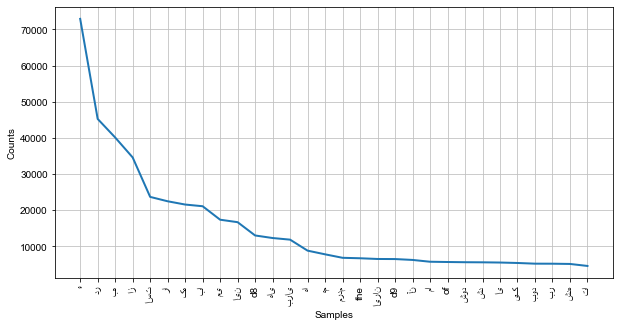

In [9]:
# words_count.max()
# words_count.most_common()

import matplotlib.pyplot as plt
plt.rcParams["font.family"] = "arial"
plt.figure(figsize=(10,5))

words_count.plot(30)

In [10]:
fre_df=pd.DataFrame(list(words_count.items()), columns = ["Word","Frequency"])
fre_df.sort_values('Frequency' , ascending=False).head(30)


,Word,Frequency
50,و,72938
71,در,45265
37,به,40134
29,از,34615
345,است,23705
85,را,22494
104,که,21592
55,با,21124
19,می,17397
174,این,16713


In [11]:
# Identified few more words to be removed along with Farsi stopwords
exclude_words2=('و','به','در','از','است','را','که','با','می','این','های','ها','برای','هم','آن','شود','شد','ای','یک','the','d9','of'
               ,'d8','to','a7','in','and','باشد','بود','در','بر','شده','تا','باید','کرد','کند','کنند', 'اما','اگر','نیست','نمی','دارد'
               ,'http','هر','که','اند','خواهد','بی','ی','چه','کرده','db','8c','s' ,'یا','is','s','a','b1','دو','این','کنیم','رو','كه',
               'اين' ,'ir','بین','پیش','دست','مورد','نیز','af','دیگر','داده','انجام','www','amp','com','for','on','with','us','کنید',
               'بعد','همین','استفاده','تر','برای','دارند','براي','داد','کردند','aa','عنوان','هیچ','یکی','وجود','هستند','کنم','بوده','داشته','پس',
               'ولی','ندارد','صورت','کردم','اینکه','م','that','it','بیشتر','کردن','شدن','چند','البته','be','سه','ع','are'
                )


path = r'/Users/behdad/Learning/TwitterBot/GetOldTweets3_Twitter_Scraper/persian-stopwords' # use your path


all_files = glob.glob(path + "/*.txt")
exclude_words = []

for filename in all_files:
    print('Reading {} content ... '.format(filename))
    with open(filename,encoding='utf-8', mode='r') as f:
        content = f.readlines()
        content = [x.strip() for x in content]
        for word in content:
            exclude_words.append(word)
        
exclude_words = set(exclude_words)

bag_of_exclude_words=exclude_words.union(exclude_words2)


mostFrequent = fre_df[~fre_df['Word'].isin(bag_of_exclude_words)]

Reading /Users/behdad/Learning/TwitterBot/GetOldTweets3_Twitter_Scraper/persian-stopwords\chars.txt content ... 
Reading /Users/behdad/Learning/TwitterBot/GetOldTweets3_Twitter_Scraper/persian-stopwords\nonverbal.txt content ... 
Reading /Users/behdad/Learning/TwitterBot/GetOldTweets3_Twitter_Scraper/persian-stopwords\persian.txt content ... 
Reading /Users/behdad/Learning/TwitterBot/GetOldTweets3_Twitter_Scraper/persian-stopwords\short.txt content ... 
Reading /Users/behdad/Learning/TwitterBot/GetOldTweets3_Twitter_Scraper/persian-stopwords\verbal.txt content ... 


In [15]:
# def remove_stopwords(text):
#     text = [word for word in text if word not in bag_of_exclude_words]
#     return text
    
# df['clean_word_nonStop'] = df['clean_text'].notnull().apply(lambda x: remove_stopwords(x))
# df.head(10)

In [86]:
mostFrequent.sort_values('Frequency' , ascending=False).head(150)

,Word,Frequency
113,ایران,6539
516,دولت,4379
674,کشور,4251
520,مجلس,3387
421,سال,3333
...,...,...
365,آزادی,693
605,حفظ,691
1431,اطلاع,690
6708,اقدامات,689


In [88]:
print('Dataset size:',df.shape)
print('Columns are:',df.columns)

Dataset size: (65024, 10)
Columns are: Index(['Username', 'Datetime', 'Text', 'retweets', 'favorites', 'hashtags',
       'tweet_date', 'tweet_time', 'Mention', 'clean_text'],
      dtype='object')


In [89]:
df

,Username,Datetime,Text,retweets,favorites,hashtags,tweet_date,tweet_time,Mention,clean_text
0,1alpr,2020-02-06 09:29:10+00:00,میلی‌لیتر,0,2,NaN,2020-02-06,09:29:10,NaN,میلی لیتر
1,1alpr,2020-02-05 09:27:28+00:00,ما گول نمی‌خوریم. یه عمریه هر طرف نگا کردیم آخوند دیدیم.,0,2,NaN,2020-02-05,09:27:28,NaN,ما گول نمی خوریم یه عمریه هر طرف نگا کردیم آخوند دیدیم
2,1alpr,2020-02-05 09:08:08+00:00,یه آخوند بی‌عمامه دیدم. داشتم نگران می‌شدم.,0,1,NaN,2020-02-05,09:08:08,NaN,یه آخوند بی عمامه دیدم داشتم نگران می شدم
3,1alpr,2020-02-05 09:06:08+00:00,آخوند چرا نداره! یعنی میرن؟,0,5,NaN,2020-02-05,09:06:08,NaN,آخوند چرا نداره یعنی میرن
4,1alpr,2020-02-03 18:20:39+00:00,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده!,0,15,NaN,2020-02-03,18:20:39,NaN,ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده
...,...,...,...,...,...,...,...,...,...,...
65019,Zarghami_ez,2016-08-28 12:42:09+00:00,متاسفانه مدیریت ‌گلخانه‌ای سینمای دهه 60 با محور قراردادن سینمای شبه‌روشنفکری و جشنواره‌پسند، مو...,1,9,NaN,2016-08-28,12:42:09,NaN,متاسفانه مدیریت گلخانه ای سینمای دهه 60 با محور قراردادن سینمای شبه روشنفکری و جشنواره پسند مو...
65020,Zarghami_ez,2016-08-28 12:31:05+00:00,مرحوم #رشیدی با ایفاء نقش خوجه ممد؛پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت‌ه...,1,18,['#رشیدی'],2016-08-28,12:31:05,NaN,مرحوم رشیدی با ایفاء نقش خوجه ممد پیرمرد مبارز و مورد علاقه ترکمن ها یکی از ماندگارترین شخصیت ه...
65021,Zarghami_ez,2016-08-24 11:52:42+00:00,تصور کلی من این است که هنوز پرداخت های نجومی قطع نشده و خوب است آخرین بررسی بر روی دریافتی های د...,5,24,NaN,2016-08-24,11:52:42,NaN,تصور کلی من این است که هنوز پرداخت های نجومی قطع نشده و خوب است آخرین بررسی بر روی دریافتی های د...
65022,Zarghami_ez,2016-08-22 11:26:13+00:00,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص،با همه ...,0,9,"['#کوهنوردی', '#انتخابات']",2016-08-22,11:26:13,NaN,یک جریان سیاسی با داشتن برنامه ای مشخص وارد رقابت می شود و در مراحل نهایی برای نامزد خاص با همه ...


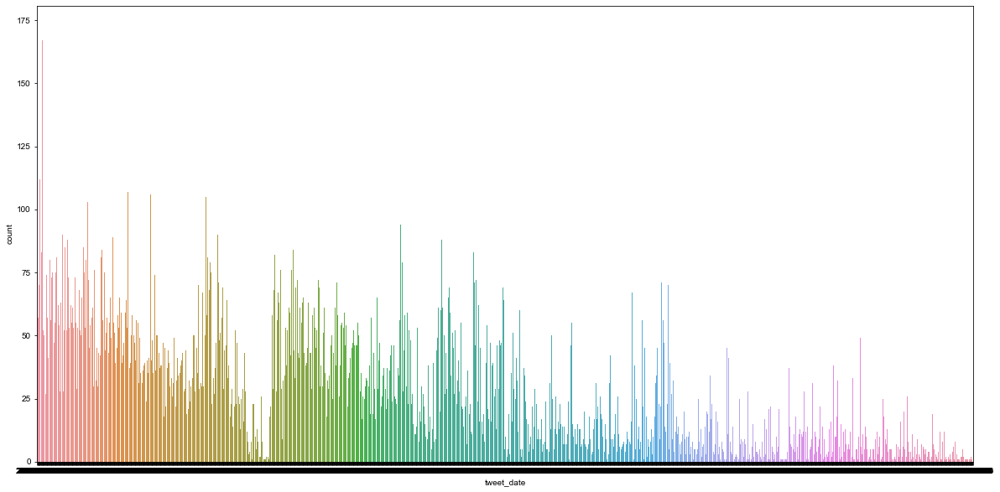

In [93]:
plt.figure(figsize=(20, 10))
plt.tight_layout()

sns.countplot(x = 'tweet_date', data = df)

In [136]:
plt.figure(figsize=(20, 10))
plt.tight_layout()
usernames=df['Username'].value_counts().nlargest(15).to_frame().reset_index()
usernames.rename(columns={'index':'Username','Username':'Count'}, inplace=True)
usernames



,Username,Count
0,khamenei_ir,3500
1,mjnanakar,3500
2,Rouhani_ir,3288
3,ebtekarm_ir,3192
4,mah_sadeghi,3083
5,Khamenei_fa,2603
6,sadjadb,2455
7,DrSaeedJalili,2428
8,hojjat_nazari,1906
9,ElhamFakhari,1689


<Figure size 1440x720 with 0 Axes>

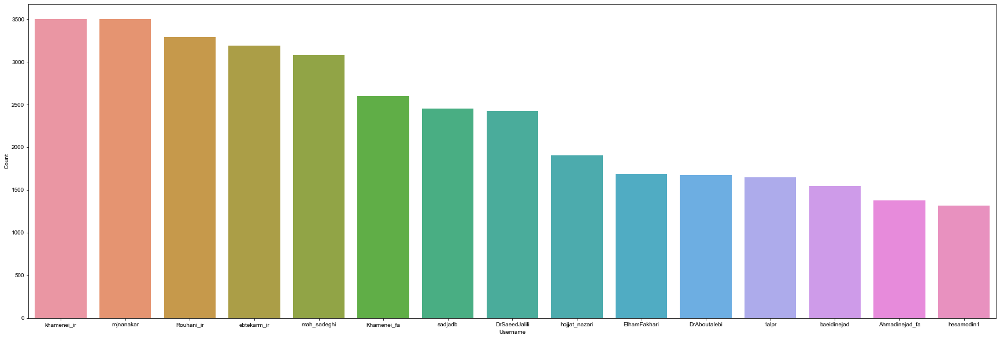

In [132]:
plt.figure(figsize=(30, 10))
plt.tight_layout()
sns.barplot(x = 'Username', y = 'Count', data = usernames)

In [135]:
plt.figure(figsize=(20, 10))
plt.tight_layout()

# hashtags=df['hashtags'].value_counts().sort_values(ascending=False).head(15).to_frame().reset_index()
hashtags=df['hashtags'].value_counts().nlargest(15).to_frame().reset_index()
hashtags.rename(columns={'index':'hashtags','hashtags':'Count'}, inplace=True)
hashtags


,hashtags,Count
0,['#روحانی'],175
1,['#ایران'],144
2,['#زنان'],140
3,['#روحانی:'],139
4,['#برجام'],116
5,"['#Jalili', '#Iranelection']",97
6,['#احمدی_نژاد'],91
7,['#Iran'],88
8,['#آینده_روشن'],59
9,['#JCPOA'],58


<Figure size 1440x720 with 0 Axes>

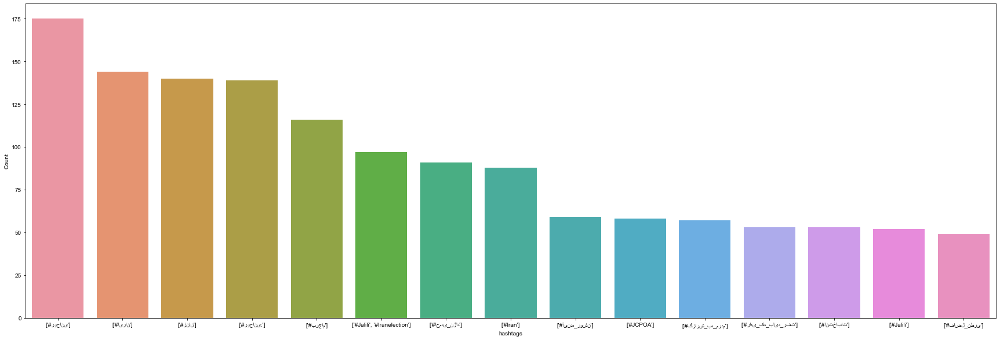

In [133]:
plt.figure(figsize=(30, 10))
plt.tight_layout()
sns.barplot(x = 'hashtags', y = 'Count', data = hashtags)

# notnull_hash = hashtags[hashtagsdf['hashtags'].notnull()]
# sns.countplot(x = 'hashtags', data = hashtags)

In [144]:
tweet_All = " ".join(str(tweet) for tweet in df.clean_text)

'میلی لیتر ما گول نمی خوریم  یه عمریه هر طرف نگا کردیم آخوند دیدیم  یه آخوند بی عمامه دیدم  داشتم نگران می شدم  آخوند چرا نداره  یعنی میرن  ببینی بچه کدوم یک از آقایون یاد گرفتن انتگرال سختش بوده  فهمیدید به ما هم بگید  تو التزام عملی ات از من بیشتره  به خاطر گوش ندادن به درس و خوندن صبح  مناظره بهزاد با باهنر  از کلاس اخراج شدم  بردمش توی دفتر ناظم  با هم خوندیم  دو ماه واقعا ترجمه عالی بود  ویراستاری هم  در کل کتاب  سختگیرانه چشمم فقط به یک ایراد ویرایشی آلارم داد  کتاب  روایت بازگشت  هشام مطر را تمام کردم  انگار آدم دیگری هستم  وسط روزهای پر آشوب لیبی  جایی در وسط راهروهای زندان ابوسلیم  خیره به منظره شورش که منتهی به کشتار ۱۲۷۰ نفر شد  در تعلیق  و با و در همه اینها  در ایران جان  فرق چیه اگه همین رای نیاورد   به من هم بند یک ماده ۲۸ اعلام شده  یعنی لابد مشکلی وجود داشته در احراز اعتقاد و التزامم به اسلام  خیلی جای نگرانی نداره به نظرم  فقط یخده باید اسلامم رو تقویت کنم   وتین یعنی رگ گردن  وتن یعنی زدن رگ گردن  بیوتن را می شود بی وطن هم خواند  وطنی که تایش دیگر دسته ای ندارد تا خود

In [150]:
from wordcloud import WordCloud, STOPWORDS , ImageColorGenerator
# !pip install python-bidi
# !pip install arabic-reshaper
from bidi.algorithm import get_display
import arabic_reshaper # this was missing in your co
import matplotlib.pyplot as plt

In [161]:
list = mostFrequent['Word'].to_list()
# list
tweet_All = " ".join(str(tweet) for tweet in list)

In [162]:
reshaped_text = arabic_reshaper.reshape(tweet_All)
bidi_text = get_display(reshaped_text)

In [163]:
# Generate a word cloud image
wordcloud = WordCloud(font_path="tahoma.ttf").generate(bidi_text)

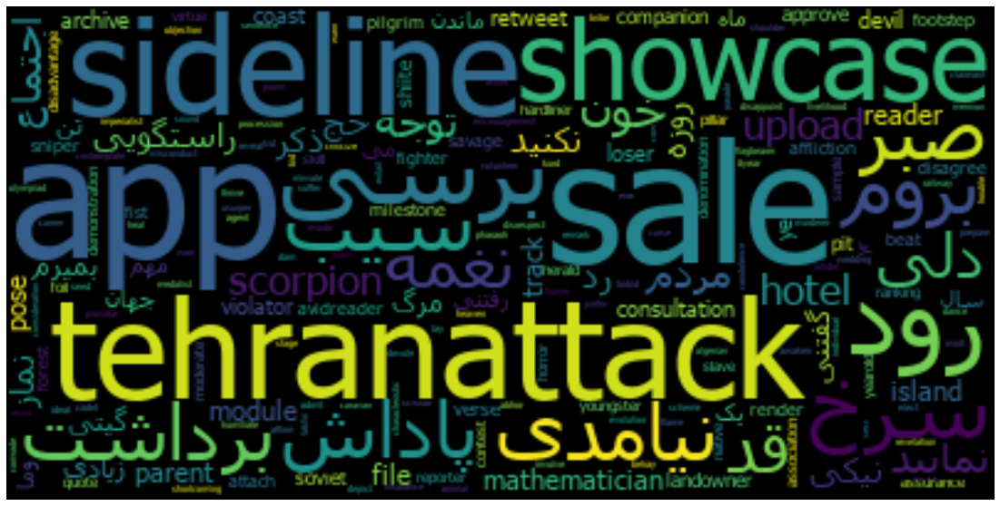

In [165]:
plt.figure(figsize=(30, 10))
plt.tight_layout()
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# tweets = df[~df['clean_text'].isin(bag_of_exclude_words)]
# plt.figure(figsize  = (250,250))
# # Create and generate a word cloud image:
# wordcloud_ALL = WordCloud(font_path="arial", max_font_size=50, background_color="black").generate(tweet_All)


# data = arabic_reshaper.reshape(tweet_All)
# data = get_display(data) # add this line
# WordCloud = WordCloud(font_path='arial', background_color='white',
#                   mode='RGB', width=2000, height=1000).generate(data)
# plt.title("wordcloud")
# plt.imshow(WordCloud)
# plt.axis("off")
# plt.show()